# **Object Detection with YOLOv8 🕵️‍♂️🚀**


*   YOLO is short for You Only Look Once.
*   It is a family of single-stage deep learning-based object detectors.
*   They are capable of more than real-time object detection with state-of-the-art accuracy.



## **Steps to Be Followed:🔍**


1.   Display information about NVIDIA GPU devices.
2.   Install the Ultralytics libraries.

3.   Pulling the data from Roboflow
4.   Train an object detection model.

5.   Valid an object detection model.
6.   Predict an object detection model.

7.   Display images with boundary Box.
8.   Upload video and predict it (Optional).

9.   Save the model.

# **Step 1: Display information about NVIDIA GPU devices**


*   In Jupyter or IPython, use **!** for running shell commands in the notebook interface, enhancing interactivity.

*   Execute **nvidia-smi** to access NVIDIA's GPU management interface, providing real-time details on GPU utilization and memory usage, crucial for tasks like deep learning.


In [ ]:
!nvidia-smi

Fri Nov 24 17:30:28 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    24W / 300W |      0MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# **Step 2: Install the Ultralytics libraries**


*  In Jupyter notebook or IPython, use the exclamation mark (**!**) to run shell commands.

*  Use the "**pip**" command-line tool to install Python packages from PyPI or other repositories.

*  Execute the "**install**" command with pip to install a specific Python package.

*  Install the "**ultralytics**" library by running the appropriate pip command.



In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 645.7/645.7 kB 9.4 MB/s eta 0:00:00


**Ultralytics is known for its YOLO (You Only Look Once) object detection implementation and other computer vision-related functionalities. It's commonly used in the field of deep learning for computer vision tasks.
🌐👁️‍🗨️**


---







*  Import the YOLO class from the Ultralytics library: **from ultralytics import YOLO**.

*  Import the os module: **import os**.

*  Import the display and Image classes from IPython.display: **from IPython.display import display, Image**.

*  Clear the output in the current cell: **display.clear_output()**.

*  Run the YOLO command-line tool in "**checks**" mode using a shell command: **!yolo mode=checks**.

In [ ]:
from ultralytics import YOLO
import os
from IPython.display import display, Image
from IPython import display
display.clear_output()
!yolo mode=checks

Traceback (most recent call last):
  File "/usr/local/bin/yolo", line 8, in <module>
    sys.exit(entrypoint())
  File "/usr/local/lib/python3.10/dist-packages/ultralytics/cfg/__init__.py", line 392, in entrypoint
    raise ValueError(f"Invalid 'mode={mode}'. Valid modes are {MODES}.\n{CLI_HELP_MSG}")
ValueError: Invalid 'mode=<module 'ultralytics.utils.checks' from '/usr/local/lib/python3.10/dist-packages/ultralytics/utils/checks.py'>'. Valid modes are ('train', 'val', 'predict', 'export', 'track', 'benchmark').

    Arguments received: ['yolo', 'mode=checks']. Ultralytics 'yolo' commands use the following syntax:

        yolo TASK MODE ARGS

        Where   TASK (optional) is one of ('detect', 'segment', 'classify', 'pose')
                MODE (required) is one of ('train', 'val', 'predict', 'export', 'track', 'benchmark')
                ARGS (optional) are any number of custom 'arg=value' pairs like 'imgsz=320' that override defaults.
                    See all ARGS at https://d

# **Step 3: Pulling the data from Roboflow**

## About the dataset:📊

*   The dataset comprises images **X-ray Airport Prohibited Items**.Which was taken from the roboflow website.

*   It contains **8295 images** divided into three folders: **train**, **valid** and **test**.

*   It divided into **5 classes** which are: **Gun**, **Knife**, **Pliers**, **Scissors**, and **Wrench**.

In [ ]:
# Install the roboflow library and import the Roboflow class
!pip install roboflow
from roboflow import Roboflow

# Create an instance of the Roboflow class with the provided API key
rf = Roboflow(api_key="c9trYGz3a7NgI0QYCPun")

# Access the specified workspace, project, and version using the Roboflow API
project = rf.workspace("mahmoud-m-hdyxu").project("x-ray-airport-prohibited-items")
dataset = project.version(1).download("yolov8")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.3/63.3 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 37.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.2/72.2 kB 11.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 9.4 MB/s eta 0:00:00
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.1.1
    Uninstalling pyparsing-3.1.1:
      Successfully uninstalled pyparsing-3.1.1
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.8.1.78
    Uninstalling opencv-python-headless-4.8.1.78:
      Successfully uninstalled opencv-python-headless-4.8.1.78
  Attempting uninstall: idna
    Found existin

loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.0.217, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to X-ray-Airport-Prohibited-Items-1 in yolov8:: 100%|██████████| 16602/16602 [00:02<00:00, 7438.46it/s]


**This code snippet installs the "roboflow" Python package and utilizes the Roboflow library to interact with a specific project on the Roboflow platform. After authenticating with the provided API key, it accesses a designated workspace and project, then downloads the dataset associated with version 1 in the "yolov8" format. This involves obtaining annotated images and metadata, configured for training a YOLOv8 object detection model.🤖**


---



# **Step 4: Train an object detection model**
**Training a YOLO (You Only Look Once) object detection model using a specific version called YOLOv8.🚀**
1.  Task and Mode:
*   Task: Specifies that the task to be performed is object **detection**.
*   Mode: Sets the mode to "**train**," indicating that the model will be trained.

2.  Model:
*   Specifies the YOLO model file to be used for training. The model file is named "**yolov8m.pt**."

3.  Data:
*   Specifies the path to the dataset configuration file (**data.yaml**).
*   This YAML file typically contains information about the dataset, such as file paths, number of classes, etc.
*   In **data.yaml**, train , valid and test extensions have been changed depending on their location in the data.

4.  Training Parameters:
*   Number of epochs: **80 epochs**. Training epochs represent the number of times the entire training dataset is passed through the model during training.
*   Input image size: Resizing input images to **640x640 pixels** during training.








In [ ]:
!yolo task=detect mode=train model=yolov8m.pt data={dataset.location}/data.yaml epochs=80 imgsz=640

100% 49.7M/49.7M [00:00<00:00, 413MB/s]
Ultralytics YOLOv8.0.217 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/X-ray-Airport-Prohibited-Items-1/data.yaml, epochs=80, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classe

**Observation :**

The provided output represents the training progress and evaluation results of a **YOLOv8** object detection model over 80 epochs.
Each epoch shows GPU memory usage, loss values, and processing statistics.
The training progress displays the completion percentage and time for each batch.
Class-wise and overall statistics are reported after each epoch, providing insights into precision, recall, and mean average precision.
The model is then evaluated on a validation dataset, and the final section summarizes the overall performance metrics, including precision, recall, and mean average precision for each class.
These details are crucial for assessing and refining the model's performance during training.
The output indicates that the model achieved a mAP of **0.935** on the validation set, demonstrating its effectiveness in detecting various object classes.


---




**The confusion matrix to visualizing the results of an object detection model training, particularly for assessing the model's performance.📅**

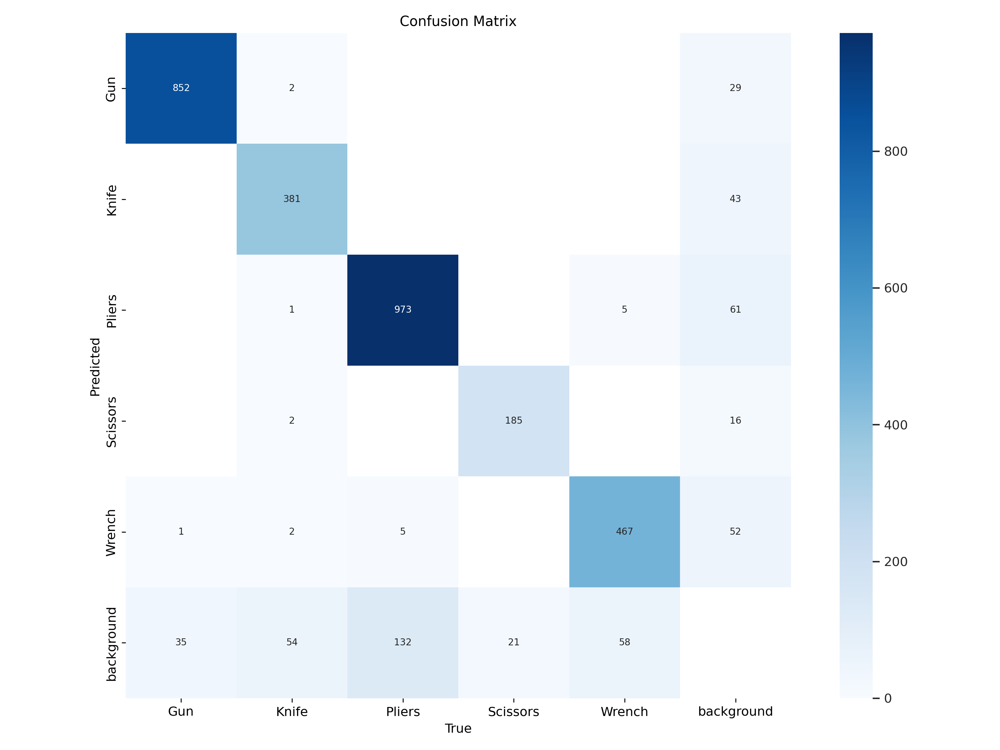

In [ ]:
Image(filename=f'/content/runs/detect/train/confusion_matrix.png', width=900)

**Observation :**

A confusion matrix is a table that is often used to evaluate the performance of a classification model. It shows the number of correct and incorrect predictions made by the model on a set of test data, broken down by class. The rows of the matrix represent the true classes, while the columns represent the predicted classes. Each cell in the matrix contains a count that indicates the number of instances that fall into a particular combination of true and predicted classes.


---



**Displayed a plot chart that includes several values: box loss, cls loss, dfl loss in train/val, and precision loss, and recall loss metrics , also mAP50 , mAP50-95 metrics.📉**

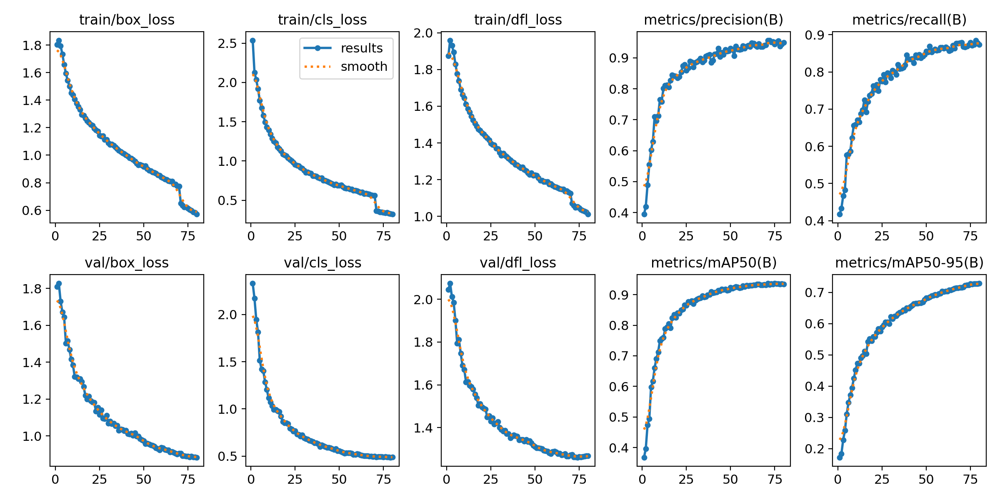

In [ ]:
Image(filename=f'/content/runs/detect/train/results.png', width=1000)

**Observation :**

- Box Loss: This refers to the loss associated with the bounding box regression.
- Cls Loss: This represents the loss associated with the classification task.
- DFL Loss: DFL stands for "Dynamic Feature Learning." The DFL loss is related to the refinement of features within a convolutional neural network (CNN) during the training process.
- Precision Loss: Precision is a metric that measures the proportion of true positive predictions (correctly predicted positives) out of all positive predictions. The precision loss refers to the decrease or increase in precision as the model is trained.
- Recall Loss: Recall is a metric that measures the proportion of true positive predictions out of all actual positives. The recall loss represents the change in recall as the model is trained.
- mAP50: mAP50 stands for mean Average Precision at an IoU threshold of 0.5, mAP50 calculates the average precision across different object classes at this IoU threshold.
- mAP50-95: mAP50-95 represents the mean Average Precision calculated over a range of IoU thresholds, specifically from 0.5 to 0.95, It calculates the average precision across different object classes, taking into account the precision and recall values at each IoU threshold from 0.5 to 0.95 and then averaging them.


---



# **Step 5: Valid an object detection model**
**Valitied a YOLO (You Only Look Once) object detection model.🚀**
1.  Task and Mode:
*   Task: Specifies that the task to be performed is object detection.
*   Mode: Sets the mode to "val," indicating that the validation set will be used for evaluation.

2.  Model:
*   Specifies the path to the YOLO model file to be used for detection. The model file is named "best.pt" and is located in the directory /content/runs/detect/train/weights/.

3.  Data:
*   Specifies the path to the dataset configuration file (data.yaml).
*   This YAML file typically contains information about the dataset, such as file paths, number of classes, etc.


In [ ]:
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

Ultralytics YOLOv8.0.217 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25842655 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/X-ray-Airport-Prohibited-Items-1/valid/labels.cache... 1660 images, 0 backgrounds, 0 corrupt: 100% 1660/1660 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 104/104 [00:19<00:00,  5.37it/s]
                   all       1660       3176      0.951      0.875      0.935      0.729
                   Gun       1660        888      0.976      0.948      0.982      0.813
                 Knife       1660        442      0.962      0.858      0.913      0.682
                Pliers       1660       1110      0.953       0.86      0.933      0.731
              Scissors       1660        206      0.953      0.893      0.938        0.7
                Wrench       1660        530      0.909      0.815      0.911      0.719
Speed: 0

**Observation :**

The provided output is from Ultralytics **YOLOv8**, a version of the YOLO object detection model. It showcases the system information, model summary, and validation results. The model has **218 layers**, **25.8 million parameter**s, and operates on a **Tesla V100 GPU**. During validation on **1660 images**, it achieved good precision and recall for various object classes such as **Gun, Knife, Pliers, Scissors, and Wrench**. The evaluation includes metrics like **mAP50 and mAP50-95**. The model's processing speed is detailed, and results are saved for further analysis.


---



# **Step 6: Predict an object detection model**
**Predicted a YOLO (You Only Look Once) object detection model.🚀**
1.  Task and Mode:
*   Task: Specifies that the task to be performed is object detection.
*   Mode: Sets the mode to "predict," indicating that the trained model will be used for making predictions on new data.

2.  Model:
*   Specifies the YOLO model file to be used for prediction. The model file is named "best.pt" and is located in the directory /content/runs/detect/train/weights/.

3.  Confidence Threshold:
*   Specifies the confidence threshold for object detection. Objects with confidence scores below 0.5 will likely be filtered out.

4.  Source:
*   Specifies the source directory containing the images on which predictions will be made.


In [ ]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.5 source={dataset.location}/test/images

Ultralytics YOLOv8.0.217 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25842655 parameters, 0 gradients, 78.7 GFLOPs

image 1/829 /content/X-ray-Airport-Prohibited-Items-1/test/images/P00031_jpg.rf.6aa97968688ce3d831ba7bbb5967ddb7.jpg: 640x640 2 Guns, 1 Knife, 9.2ms
image 2/829 /content/X-ray-Airport-Prohibited-Items-1/test/images/P00060_jpg.rf.f56aa6077c712e468750861b9cf0caff.jpg: 640x640 1 Gun, 2 Knifes, 9.3ms
image 3/829 /content/X-ray-Airport-Prohibited-Items-1/test/images/P00061_jpg.rf.5724df66e522bf6dabdbe9be1801415b.jpg: 640x640 1 Knife, 9.2ms
image 4/829 /content/X-ray-Airport-Prohibited-Items-1/test/images/P00082_jpg.rf.c0eef34541ae4179996b8236c6c69644.jpg: 640x640 1 Gun, 1 Knife, 9.2ms
image 5/829 /content/X-ray-Airport-Prohibited-Items-1/test/images/P00112_jpg.rf.83abe919ca072c1b853c631e720c8c31.jpg: 640x640 2 Guns, 3 Knifes, 9.2ms
image 6/829 /content/X-ray-Airport-Prohibited-Items-1/test/images/P00128_jpg.rf.7

**Observation :**

The model predicted all **829 images** in the **test folder** and noticed that there were **23 images** that it didn't recognize (**no detections**).

# **Step 7: Display images with boundary Box💼**
*   Display all the images that were predicted from the test folder with the Boundary Box and the ratio appearing.
*   Display the selected image that were predicted from the test folder with the Boundary Box and the ratio appearing.



In [ ]:
# Import necessary modulesi
import glob
from IPython.display import Image, display

# Iterate through all JPEG images in the specified directory
for image_path in glob.glob(f'/content/runs/detect/predict/*.jpg'): #note if you doing * it's mean all image and maybe hang

  # Display each image with a height of 600 pixels
  display(Image(filename=image_path, height=600))

  #Print a newline for better visualization separation
  print('\n')

**Observation :**

When you put all the images on display, the run may get stuck.

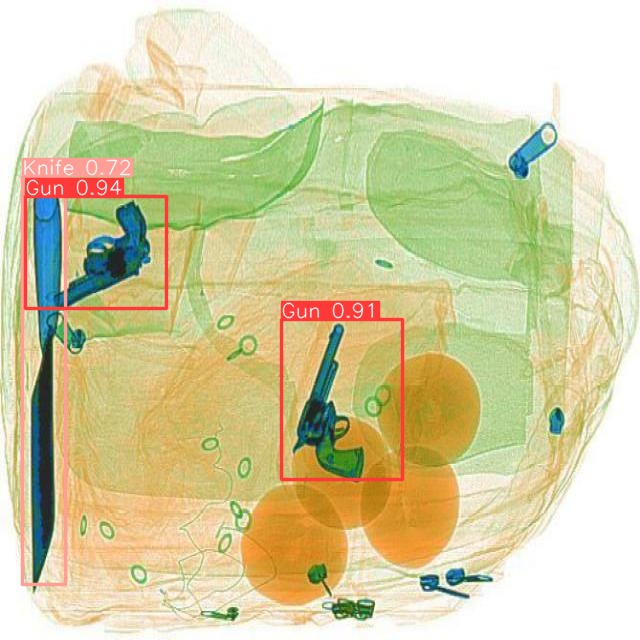

In [ ]:
# Import the necessary modules for displaying images
from IPython.display import Image, display

# Specify the path to the image you want to display
image_path = '/content/runs/detect/predict/P00280_jpg.rf.ee8e498d0a8752fbe2810fa779eb7adb.jpg'

# Display the specified image
display(Image(filename=image_path, height=600))

**Observation :**

The image contains two classes:🔫🔪
- Two of gun with a ratio of 0.91 and 0.94
- One of knife with a ratio of 0.72

# **Step 8: Upload video and predict it🎥(Optional)**
1. Display the basic video that I want the model to predict based on what I trained and give me a Boundary Box and its percentages.
2. Predict the video and put a Boundary Box on it and its percentages.
3. Save the video after applying the model.

In [ ]:
# Import the necessary modules for working with HTML and base64 encoding
from IPython.display import HTML
from base64 import b64encode

# Path to your video file
video_path = '/content/final_video_oreg.mp4'

# Read the video file and convert it to base64
with open(video_path, 'rb') as video_file:
    video_encoded = b64encode(video_file.read()).decode('utf-8')

# Create the HTML code to embed the video
video_html = f'''
<video width="640" height="360" controls>
  <source src="data:video/mp4;base64,{video_encoded}" type="video/mp4">
  Your browser does not support the video tag.
</video>
'''

# Display the HTML code
HTML(video_html)

**Observation :**

The original video contains 6 bags that the model was trained on, and two bags that do not contain any prohibited items and the model was not trained on them.

**Predict the video and put a Boundary Box on it and its percentages🔲**
1.  Task and Mode:
*   Task: Specifies that the objective is to perform object detection.
*   Mode: Sets the mode to "predict," indicating that the trained model will be used for making predictions on new data.

2.  Model:
*   Specifies the YOLO model file to be used for prediction. The model file is named "best.pt" and is located in the directory /content/runs/detect/train/weights/.

3.  Confidence Threshold:
*   Specifies the confidence threshold for object detection. Objects with confidence scores below 0.5 will likely be filtered out.

4.  Source:
*   Specifies the source input data for object detection. In this case, it's a video file named final_video_oreg.mp4. The YOLO model will process this video to detect objects within it.

In [ ]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.5 source=/content/final_video_oreg.mp4

Ultralytics YOLOv8.0.217 🚀 Python-3.10.12 torch-2.1.0+cu118 CUDA:0 (Tesla V100-SXM2-16GB, 16151MiB)
Model summary (fused): 218 layers, 25842655 parameters, 0 gradients, 78.7 GFLOPs

video 1/1 (1/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 65.8ms
video 1/1 (2/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 9.5ms
video 1/1 (3/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 9.0ms
video 1/1 (4/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 8.7ms
video 1/1 (5/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 8.9ms
video 1/1 (6/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 9.6ms
video 1/1 (7/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 9.2ms
video 1/1 (8/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 8.5ms
video 1/1 (9/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 8.3ms
video 1/1 (10/2381) /content/final_video_oreg.mp4: 352x640 (no detections), 8.3ms
video 

**Save the video after applying the model💾**
- The provided FFmpeg command is a comprehensive tool for multimedia processing, specifically focused on converting a video file from one format to another.
- This FFmpeg command, executed with the ! symbol indicating a shell command, is designed to transform a video file. The input file is specified with the -i flag, pointing to the location of a video file named final_video_oreg.avi located at /content/runs/detect/predict2. The -vcodec libx264 flag signifies the use of the H.264 video codec for compression during the conversion process.
- Finally, the output file is designated as final_video.mp4. Upon execution, FFmpeg processes the input video, applies the chosen video codec, and produces a new video file in MP4 format named final_video.mp4.
- This command is valuable for tasks such as changing video formats or compressing videos with a different codec, offering flexibility in multimedia file manipulation.

In [ ]:
!ffmpeg -i {'/content/runs/detect/predict2/final_video_oreg.avi'} -vcodec libx264 {'final_video.mp4'}

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

# **Step 9: Save the model💾**
- Create a connection between Colab notebook and Google Drive.
- Store the trained model on Google Drive, making it easy to retrieve the model file and share it across different sessions or with collaborators.


In [ ]:
# Mount Google Drive in Colab
from google.colab import drive

# Mount the Google Drive at '/content/drive'
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Import TensorFlow and the necessary modules
import tensorflow as tf
from tensorflow.keras.models import load_model

# Assuming you have a pre-trained MobileNetV2 model loaded from ImageNet weights
model = tf.keras.applications.MobileNetV2(weights='imagenet', input_shape=(224, 224, 3))

# Save the model to the specified path
model.save('/content/drive/MyDrive/Save_the_model/xray_model_80.h5')

14536120/14536120 [==============================] - 1s 0us/step


You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
